Data Engineer Take Home Project
=========

We’ve found that one of the best ways to evaluate engineering candidates is a take-home project. This project gives you a chance to work on some relevant code at home, and it gives us something concrete to discuss during your in-person interviews. Please choose the technologies that allow you to put your best foot forward. There are no bonus points given for finishing the project quickly.

# The Project

## Preface
For test delivery, the data set here is relatively small (data from [Denver's open data catalog](https://www.denvergov.org/opendata)).  You should approach this test as though the data were 1000x the actual size and frequently updated by real-time events.


#### Task 1 
Download data about [Denver 311 service requests](Company_s3_Bucket.csv.zip) ([original source](http://data.denvergov.org/download/gis/311_service_requests/csv/311_service_requests.csv)) and [traffic accidents](Company_s3_Bucket.csv.zip) ([original source](http://data.denvergov.org/download/gis/traffic_accidents/csv/traffic_accidents.csv)). This data set, which is *not* perfect, contains events in the City and County of Denver for the previous 12 months. Even as the data grows at a high rate, it should be reasonably queryable for the tasks below.

#### Task 2
Write a process to transform the data into a queryable data store. The city updates these files periodically, with a rolling 1-year window. The process should be flexible enough to be able to ingest new data when it is available. Queries against the data store should perform well even with rapid data growth.

#### Task 3
Explore the data to find interesting patterns or trends and then write queries for the resulting reports. The types of questions you might ask include the following:

- Are there seasonal trends to the different types of events?
- Which types of events are more common by geographic areas, as defined by coordinates or neighborhood?
- How long are typical response/resolution times? Do these differ by type of event, geography, or other factors?
- What correlations are there b|etween the two data sets?

Treat your code as if it will be used in production to deliver insights to users. Think about readability and maintainability, and consider automated testing of code wherever possible.

# Deliverable
Please provide the code for the assignment either in a private repository (GitHub or Bitbucket) or as a zip file.


# Approach used

* The approch will be 
* 1 - Read in all data from the source
* 2 - Clean and process that data
* 3 - Write to sqlite DB to create initial data set
* 4 - Update sqlite db by pulling in data from source system, filtering to just new records, processing and loading to db
* 5 - query and visualization using pyspark to keep responsive high with high data volume



# Ingest Data

Pull in data from s3 Bucket - Unzip - and extract the user selected csv file

In [1]:
from utils import clean_accidents_df, read_remote_csv, write_df_to_sqlite
from IPython.display import display
import pandas as pd
import requests
import zipfile
from urllib.request import urlopen
from io import BytesIO
from pathlib import Path
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from pandas.plotting import register_matplotlib_converters
register_matplotlib_converters()

In [2]:
# Pull data from s3 bucket to pandas dataframe
service_request_df = read_remote_csv(
    "Company_s3_Bucket.csv.zip", "311_service_requests.csv")
accidents_df = read_remote_csv(
    "Company_s3_Bucket.csv.zip", "traffic_accidents.csv")

# Data Exploration

In [3]:
# Show high level view of the two datasets
display(service_request_df.info())
display(accidents_df.info())

# Division, Major Area and Topic are empty column
# Will leave in as could be used in future would need functional input to drop

# Accident data has no empty columns

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 470641 entries, 0 to 470640
Data columns (total 24 columns):
 #   Column                   Non-Null Count   Dtype 
---  ------                   --------------   ----- 
 0   Case Summary             470614 non-null  object
 1   Case Status              470641 non-null  object
 2   Case Source              470633 non-null  object
 3   Case Created Date        470641 non-null  object
 4   Case Created dttm        470641 non-null  object
 5   Case Closed Date         405021 non-null  object
 6   Case Closed dttm         405021 non-null  object
 7   First Call Resolution    412856 non-null  object
 8   Customer Zip Code        328178 non-null  object
 9   Incident Address 1       127827 non-null  object
 10  Incident Address 2       4883 non-null    object
 11  Incident Intersection 1  24528 non-null   object
 12  Incident Intersection 2  24528 non-null   object
 13  Incident Zip Code        118641 non-null  object
 14  Longitude           

None

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 123664 entries, 0 to 123663
Data columns (total 19 columns):
 #   Column                  Non-Null Count   Dtype 
---  ------                  --------------   ----- 
 0   INCIDENT_ID             123664 non-null  object
 1   OFFENSE_ID              123664 non-null  object
 2   OFFENSE_CODE            123664 non-null  object
 3   OFFENSE_CODE_EXTENSION  123664 non-null  object
 4   OFFENSE_TYPE_ID         123664 non-null  object
 5   OFFENSE_CATEGORY_ID     123664 non-null  object
 6   FIRST_OCCURRENCE_DATE   123664 non-null  object
 7   LAST_OCCURRENCE_DATE    571 non-null     object
 8   REPORTED_DATE           123664 non-null  object
 9   INCIDENT_ADDRESS        108918 non-null  object
 10  GEO_X                   123664 non-null  object
 11  GEO_Y                   123664 non-null  object
 12  GEO_LON                 123664 non-null  object
 13  GEO_LAT                 123664 non-null  object
 14  DISTRICT_ID             123664 non-n

None

# Validate Data in Columns - Service Request

- Service Requests - Analyze Columns
- Case Summary - free text field 111,084 distinct values. 103,018 have a count less than 5. Field will need to be binned for any analysis
- Case Status - Clean pre-select field
- Case Source - Clean pre-selected field
- Case Created fields - Clean no Null 
- Case Closed Date - 65K nulls
- First Call Resolution - Clean only Y or N
- Customer Zip Code - lots blanks - too many distinct values - Will require cleaning
- Incident Address 1 - lots of blanks- low count per value
- Incident Address 2 - lots of blanks- low count per value    
- Incident Intersection 1 - lots of blanks- low count per value
- Incident Intersection 2 - lots of blanks- low count per value
- Incident Zip Code - Lots of blank values, 7717 distinct values - Colorado only has 521 Zip codes - Will require cleaning
- Longitude - some missing data - analyze accuracy in more detail
- Latitude- some missing data - analyze accuracy in more detail
- Agency - clean  - which agency is responsible
- Type - clean - type of request 6 distinct values
- Council District - lots of blanks - number ID for district
- Police District  - lots of blanks - number ID for district      
- Neighborhood - lots of blanks - name of neigborhood

**Key takeaways** - no key field

In [4]:
# Need to convert date time values to Date time
# Convert to date time
service_request_df['Case Created dttm'] = pd.to_datetime(
    service_request_df['Case Created dttm'])
service_request_df['Case Closed dttm'] = pd.to_datetime(
    service_request_df['Case Closed dttm'])
# Calculated Time to Resolve Request
service_request_df['Time_To_Resolve_Requests_hour'] = (
    service_request_df['Case Closed dttm'] - service_request_df['Case Created dttm']).dt.total_seconds()/3600
# dttm always provides more information so we can drop the case create and case closed
service_request_df.drop(
    ['Case Created Date', 'Case Closed Date'], axis=1, inplace=True)

# Validate Date Fields - Service Requests

<AxesSubplot:>

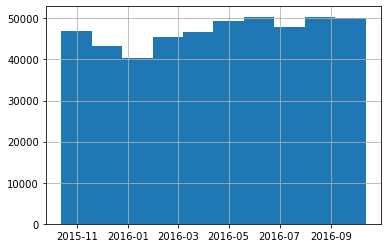

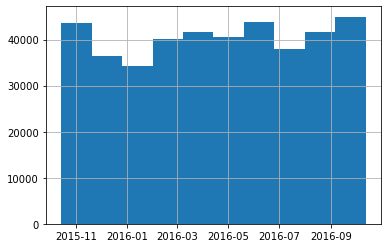

65620 requsts with invalid created or closing dates


,Case Summary,Case Status,Case Source,Case Created dttm,Case Closed dttm,First Call Resolution,Customer Zip Code,Incident Address 1,Incident Address 2,Incident Intersection 1,...,Latitude,Agency,Division,Major Area,Type,Topic,Council District,Police District,Neighborhood,Time_To_Resolve_Requests_hour
263236,setback and bulk plane inspection,Closed - Approved,Phone,2016-06-13 19:06:11,NaT,NaN,NaN,4145 N Vrain St,NaN,NaN,...,39.77377093767972,Community Planning & Development,NaN,NaN,Request,NaN,1,1,NaN,NaN
112674,Replacement Cart,In-Progress,Phone,2016-09-29 16:50:10,NaT,N,NaN,1359 N Gaylord St,Apt 3,NaN,...,39.73793110423815,Public Works,NaN,NaN,Request,NaN,10,6,NaN,NaN
198824,illegal dumping,In-Progress,Phone,2016-07-29 16:27:25,NaT,NaN,NaN,2040 S Fox St,NaN,NaN,...,39.67954094585905,Public Works,NaN,NaN,Complaint,NaN,7,3,NaN,NaN
445039,LOOSE DOG,New,Phone,2016-01-24 23:21:55,NaT,NaN,NaN,NaN,NaN,I-70,...,39.78335442276949,Environmental Health,NaN,NaN,Request,NaN,NaN,NaN,NaN,NaN
194942,Overgrown Vegetation,Routed to Agency,Phone,2016-08-01 21:16:26,NaT,NaN,80204,453 N Galapago St,NaN,NaN,...,39.7236104366734250,Community Planning & Development,NaN,NaN,Complaint,NaN,7,3,NaN,NaN


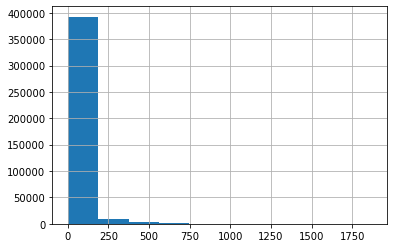

In [5]:
# Display created date histogram
display(service_request_df['Case Created dttm'].hist())
plt.show()
# Data looks distrubuted - no obvious outliers for created date

# Display closed date histogram
service_request_df['Case Closed dttm'].hist()
plt.show()
# Data looks distrubuted - no obvious outliers for created date

# Investigate invalide time to resolve
invalid_dates = service_request_df[np.isnan(
    service_request_df['Time_To_Resolve_Requests_hour'])]
print(invalid_dates.shape[0], 'requsts with invalid created or closing dates')
service_request_df['Time_To_Resolve_Requests_hour'].hist()
invalid_dates.sample(5)

# Validate Latitude and Longitude - Service Request

In [6]:
import folium
from folium.plugins import HeatMap


def create_geo_heatmap(df: pd.DataFrame, Latitude=None, Longitude=None, list_val=None, is_list=False, zoom=10) -> None:
    # Create map with starting coordinates in Denver
    out_map = folium.Map(
        location=[39.7392, -104.9903], zoom_start=zoom, clustered_marker=True)
    if is_list == False:
        # Create new df with just non-null coordinates
        map_df = df.dropna(axis=0, subset=[Latitude, Longitude])

        # Create list of Lat/Long cooridanted
        geo_list = [[row[Latitude], row[Longitude]]
                    for index, row in map_df.iterrows()]
    else:
        geo_list = [row for row in df[list_val] if row is not None]

    # Plot it on the map
    HeatMap(geo_list).add_to(out_map)

    # Display the map
    display(out_map)


create_geo_heatmap(service_request_df, Latitude='Latitude',
                   Longitude='Longitude', zoom=2)
# Data quality is a major issue - the entire US and Europe are lighting up - needs to be cleaned

### Clean Lat Long

In [7]:
import geopy.distance


def calc_distance(x: pd.DataFrame) -> float:
    Denver_coordinates = (39.7392, -104.9903)
    row_coordinated = (x['Latitude'], x['Longitude'])
    return geopy.distance.distance(Denver_coordinates, row_coordinated).miles


# Calculate how far from denver each set of coordinates is
service_request_df['Coordinates distance'] = service_request_df[['Latitude', 'Longitude']].apply(
    lambda x: calc_distance(x) if not pd.isnull(x['Latitude']) and not pd.isnull(x['Longitude']) else None, axis=1)

# Keep only cooridnates with 100 miles of Denver
# Other values are presumbed to typos/malfuction and will be discarded
# More functional knowledge of coordinates are collected (automated vs manual input) to adjust coordinates
service_request_df['Coordinates cleaned'] = service_request_df[['Latitude', 'Longitude', 'Coordinates distance']].apply(
    lambda x: [x['Latitude'], x['Longitude']] if not pd.isnull(x['Coordinates distance'])
    and x['Coordinates distance'] < 100 else None, axis=1)

create_geo_heatmap(service_request_df, is_list=True,
                   list_val='Coordinates cleaned', zoom=6)
# Looks much better, all coordinates are in the greater denver area

### Clean up Zip code field

In [8]:
# Clean up and combine Zip code columns into one column. Users seem to fill out Zip code in one of these two columns
service_request_df['Zip_Code_Combined'] = service_request_df[['Customer Zip Code', 'Incident Zip Code']].apply(
    lambda x: x['Incident Zip Code'] if not pd.isnull(x['Incident Zip Code']) and x['Incident Zip Code'].isnumeric() else x['Customer Zip Code'], axis=1)

# Convert to 5 digit zip codes - remove trailing 4 digits
service_request_df['Zip_Code_Combined'] = service_request_df['Zip_Code_Combined'].map(
    lambda x:  x[:5] if type(x) == str else str(x)[:5])
# Remove non numeric values and values that are not 5 digits
service_request_df['Zip_Code_Combined'] = service_request_df['Zip_Code_Combined'].map(
    lambda x:  x if len(x) == 5 and x.isnumeric() else None)
# Select on zips that start with 80, or 81 as all Co Zip codes start with those values
service_request_df['Zip_Code_Combined'] = service_request_df['Zip_Code_Combined'].map(
    lambda x:  x if x is not None and (x.startswith('80') or x.startswith('81')) else None)

service_request_df['Zip_Code_Combined'].value_counts()
# still 600+ zip codes entires

80219    25749
80205    17777
80204    17050
80211    16458
80210    15382
         ...  
80285        1
81430        1
80287        1
80048        1
81002        1
Name: Zip_Code_Combined, Length: 637, dtype: int64

### Add Additional Features - Service Requests

In [9]:
# Convert Created Date to day of the week
service_request_df['Day_of_week_created'] = service_request_df['Case Created dttm'].dt.day_name()
service_request_df['Day_of_week_number'] = service_request_df['Case Created dttm'].dt.weekday

# Create Column with Months
service_request_df['Case_Created_Month'] = service_request_df['Case Created dttm'].dt.month


# Bin by hour
service_request_df['Case_Created_Hour'] = service_request_df['Case Created dttm'].map(
    lambda x: (x.hour))

# Validate Data in Columns - Accidents

- INCIDENT_ID -  Incident ID - no blanks 
- OFFENSE_ID - Unique ID incident + offense code +Offense code extension - no blanks
- OFFENSE_CODE_EXTENSION - incident code - no blanks
- OFFENSE_TYPE_ID - More detailed view of OFFENSE_CATEGORY_ID - no blanks
- OFFENSE_CATEGORY_ID - high level text summary of incident
- FIRST_OCCURRENCE_DATE - Date field - no blank
- LAST_OCCURRENCE_DATE - date field - has blanks
- REPORTED_DATE - Date field - no blanks
- INCIDENT_ADDRESS - free text field - has blanks
- GEO_X - X coordinates no blanks
- GEO_Y - Y coordinates no blanks
- GEO_LON - Longitude coordinates - no blanks
- GEO_LAT - Latitude coordinates - no blanks
- DISTRICT_ID - numeric code - no blanks
- PRECINCT_ID - numeric code - no blanks
- NEIGHBORHOOD_ID - text field - 78 unique records
- BICYCLE_IND - numeric code - boolean yes/no
- PEDESTRIAN_IND - numeric code - boolean yes/no

**Key takeaways** - OFFENSE_ID

False    123662
True          2
Name: Date Quality Issue, dtype: int64


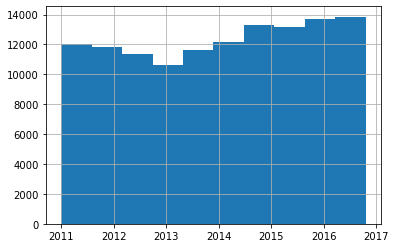

In [10]:
# Convert to date time
accidents_df['REPORTED_DATE'] = pd.to_datetime(accidents_df['REPORTED_DATE'])
accidents_df['FIRST_OCCURRENCE_DATE'] = pd.to_datetime(
    accidents_df['FIRST_OCCURRENCE_DATE'])
accidents_df['LAST_OCCURRENCE_DATE'] = pd.to_datetime(
    accidents_df['LAST_OCCURRENCE_DATE'])

# ID Date data quality - first 4 digits of incident ID appear to be year code
accidents_df["IncidentYear"] = accidents_df['INCIDENT_ID'].str[:4]
accidents_df['REPORTED_DATE_YEAR'] = accidents_df['REPORTED_DATE'].map(
    lambda x: str(x.year))
accidents_df['Date Quality Issue'] = accidents_df['REPORTED_DATE_YEAR'] != accidents_df["IncidentYear"]
print(accidents_df['Date Quality Issue'].value_counts())  # Only 2 records

# Add date features
accidents_df['Day_of_week_Reported'] = accidents_df['REPORTED_DATE'].dt.day_name()
accidents_df['Case_Created_Month'] = accidents_df['REPORTED_DATE'].dt.month
accidents_df['Case_Created_Hour'] = accidents_df['REPORTED_DATE'].map(
    lambda x: (x.hour))
accidents_df['Time_between_occurances_hour'] = (
    accidents_df['LAST_OCCURRENCE_DATE'] - accidents_df['FIRST_OCCURRENCE_DATE']).dt.total_seconds()/3600

accidents_df['REPORTED_DATE'].hist()
plt.show()
# data looks evenly distrubuted for several years

# Duplicates Check

In [11]:
# Check for duplicates
# Using OFFENSE_ID as unique key
accidents_df[accidents_df.duplicated(subset=['OFFENSE_ID', 'FIRST_OCCURRENCE_DATE',
                                             'LAST_OCCURRENCE_DATE'], keep=False)].sort_values(by=['REPORTED_DATE'], ascending=False)

# Remove Duplicates
len_df = len(accidents_df)
accidents_df.drop_duplicates(
    subset=['OFFENSE_ID', 'FIRST_OCCURRENCE_DATE', 'LAST_OCCURRENCE_DATE'], inplace=True)
len_df_clean = len(accidents_df)

print("Data length went from", len_df, "to: ", len_df_clean,
      'Duplicate row removed: ', len_df-len_df_clean)

Data length went from 123664 to:  123659 Duplicate row removed:  5


### Check for delta between date updates

,REPORTED_DATE,FIRST_OCCURRENCE_DATE,LAST_OCCURRENCE_DATE,Time_between_occurances_hour
74105,2013-01-19 17:49:59,2012-01-19 03:59:59,2013-01-19 12:00:00,8792.000278
114495,2015-01-06 08:35:00,2014-01-06 08:35:00,2015-01-06 08:35:00,8760.000000
55227,2015-12-04 13:25:59,2015-07-09 12:00:00,2015-12-03 09:59:59,3525.999722
39246,2014-11-30 18:33:59,2014-11-12 06:00:00,2014-11-29 15:59:59,417.999722
67224,2014-04-06 18:40:00,2014-03-29 14:00:00,2014-04-06 17:29:59,195.499722
...,...,...,...,...
34888,2013-07-08 17:30:59,2013-07-08 16:44:59,2013-07-08 16:40:00,-0.083056
34710,2013-05-23 14:19:59,2013-05-23 14:19:59,2013-05-23 14:00:00,-0.333056
57588,2013-11-21 14:48:59,2013-11-21 11:26:59,2013-11-21 11:00:00,-0.449722
28787,2012-07-09 16:43:00,2012-07-09 16:34:59,2012-07-09 15:49:59,-0.750000


<AxesSubplot:>

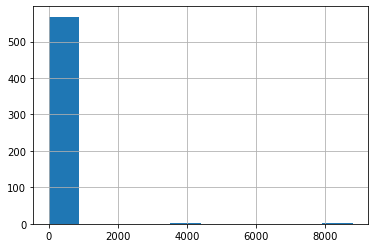

In [12]:
# output time between occurances sorted by longest gap
# This to see how long after an entry it can be updated with new data
# Assumption - data is submitted with FIRST_OCCURRENCE_DATE - can later be updated with LAST_OCCURRENCE_DATE
display(accidents_df[['REPORTED_DATE', 'FIRST_OCCURRENCE_DATE', 'LAST_OCCURRENCE_DATE', 'Time_between_occurances_hour']]
        [~pd.isnull(accidents_df['LAST_OCCURRENCE_DATE'])].sort_values(by=['Time_between_occurances_hour'], ascending=False))


accidents_df['Time_between_occurances_hour'].hist()

# Decision Tree to see feature impact

Feature: 0 Day_of_week_number, Score: 0.13358
Feature: 1 Case_Created_Month, Score: 0.22451
Feature: 2 Case_Created_Hour, Score: 0.21895
Feature: 3 First Call Resolution_N, Score: 0.04258
Feature: 4 First Call Resolution_Y, Score: 0.05223
Feature: 5 Agency_311, Score: 0.00212
Feature: 6 Agency_City Council, Score: 0.00004
Feature: 7 Agency_Clerk & Recorder, Score: 0.00017
Feature: 8 Agency_Community Planning & Development, Score: 0.01787
Feature: 9 Agency_Environmental Health, Score: 0.03524
Feature: 10 Agency_Excise & License, Score: 0.00435
Feature: 11 Agency_External Agency, Score: 0.00454
Feature: 12 Agency_Finance, Score: 0.00005
Feature: 13 Agency_Mayor's Office, Score: 0.00023
Feature: 14 Agency_Parks & Recreation, Score: 0.02328
Feature: 15 Agency_Public Works, Score: 0.06682
Feature: 16 Agency_Safety, Score: 0.00001
Feature: 17 Agency_Tech Services, Score: 0.00031
Feature: 18 Type_Complaint, Score: 0.02976
Feature: 19 Type_Compliment, Score: 0.00061
Feature: 20 Type_Inquiry, S

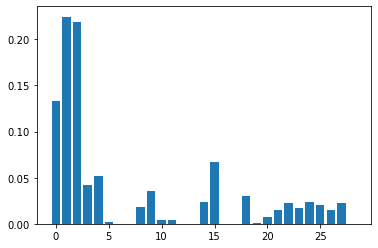

In [13]:
# decision tree for feature importance on a regression problem
from sklearn.datasets import make_regression
from sklearn.tree import DecisionTreeRegressor
from matplotlib import pyplot

feature_df = service_request_df[['First Call Resolution', 'Agency', 'Type', 'Police District',
                                 'Day_of_week_number', 'Case_Created_Month', 'Case_Created_Hour', 'Time_To_Resolve_Requests_hour']].dropna()

target_df = feature_df['Time_To_Resolve_Requests_hour']
feature_df.drop(columns=['Time_To_Resolve_Requests_hour'], inplace=True)
feature_df_encoded = pd.get_dummies(feature_df)

# define the model
model = DecisionTreeRegressor()
# fit the model
model.fit(feature_df_encoded, target_df)
# get importance
importance = model.feature_importances_
# summarize feature importance
for i, v in enumerate(importance):
    print('Feature: %i %s, Score: %.5f' %
          (i, feature_df_encoded.columns[i], v))
# plot feature importance
pyplot.bar([x for x in range(len(importance))], importance)
pyplot.show()

# key takeaways - Day of the week, month and hour of day, First call resolution and public works
# are all impactful features for time to resolve

# Analysis

# Analysis - Performance by Police Precinct

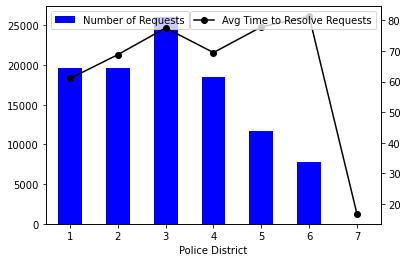

<AxesSubplot:xlabel='Police District'>

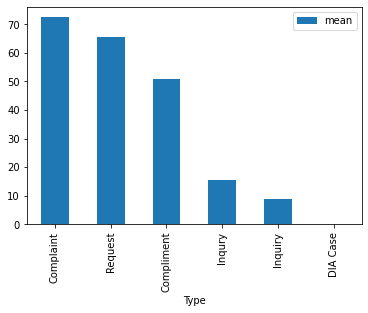

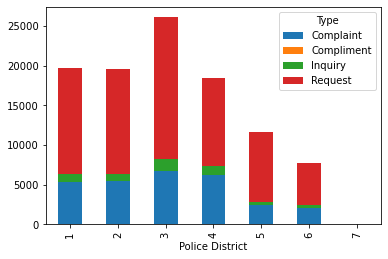

In [14]:
import matplotlib.pyplot as plt
import matplotlib
import numpy as np
import pandas as pd
import seaborn as sns

district_mean_resolution = service_request_df[['Police District', 'Time_To_Resolve_Requests_hour']].groupby(
    'Police District').agg(['mean']).reset_index()
district_count_resolution = service_request_df[['Police District', 'Case Summary']].groupby(
    'Police District').agg(['count']).reset_index()

ax = district_count_resolution[['Police District', 'Case Summary']].plot(x='Police District', kind='bar',
                                                                         color='b')
ax2 = district_mean_resolution[['Police District', 'Time_To_Resolve_Requests_hour']].plot(
    x='Police District', linestyle='-', marker='o', ax=ax, secondary_y=True, color='k')

ax.legend(['Number of Requests'], loc='upper left')
ax2.legend(['Avg Time to Resolve Requests'], loc='upper right')
plt.show()
# Analysis - Average time to resolve requests is not strongly correlated to number of requests

# The type of request greatly changes the time to resolve
service_request_df.groupby('Type')['Time_To_Resolve_Requests_hour'].agg(
    ['mean']).sort_values('mean', ascending=False).plot(kind='bar')

# Graph 3 - breaking down police districs by type of request to see if this explain why some districs with high time of resolution and low number of requests
service_request_df.groupby(['Police District', 'Type'])[
    'Case Summary'].count().unstack().plot(kind='bar', stacked=True)

# Key takeaways - Time to resolve request seems more dependant on Police district, not number of requests

# Analysis - Average Resolution Time by Date

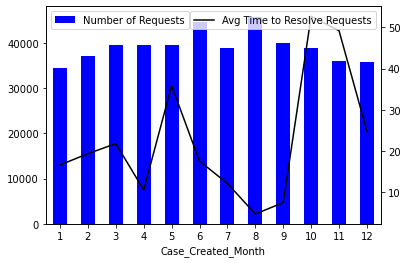

In [15]:
ax = service_request_df.groupby('Case_Created_Month')['Case Summary'].count().reset_index(
).plot(x='Case_Created_Month', kind='bar', label='Count of Requests', color='b')
ax2 = service_request_df.groupby('Case_Created_Month')['Time_To_Resolve_Requests_hour'].mean(
).reset_index().plot(y='Time_To_Resolve_Requests_hour', linestyle='-', ax=ax,  secondary_y=True, color='k')

ax.legend(['Number of Requests'], loc='upper left')
ax2.legend(['Avg Time to Resolve Requests'], loc='upper right')

# Analysis - Average time to resolve requests is not strongly correlated to number of requests

# Analysis shows an increase in requests in the summer 5,6,7,8 and a decrease in winter 11, 12, 1,2
# While time to resolve sharpely spikes at year end especially October, November

# Analysis - Average Resolution Time by Agency

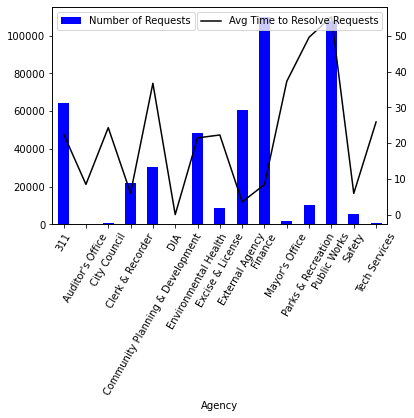

In [16]:
ax = service_request_df.groupby('Agency')['Case Summary'].count().reset_index(
).plot(x='Agency', kind='bar', label='Count of Requests', color='b')
ax2 = service_request_df.groupby('Agency')['Time_To_Resolve_Requests_hour'].mean().reset_index().plot(
    y='Time_To_Resolve_Requests_hour', linestyle='-', ax=ax,  secondary_y=True, color='k', rot=60)

ax.legend(['Number of Requests'], loc='upper left')
ax2.legend(['Avg Time to Resolve Requests'], loc='upper right')

# Accident Analysis - By Hour when do they occur?

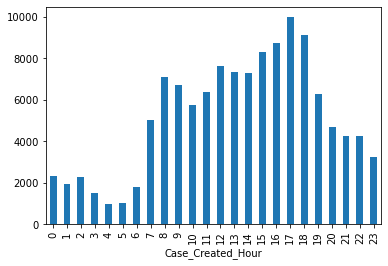

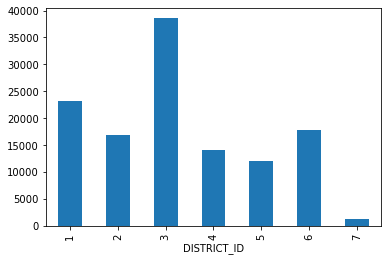

<AxesSubplot:xlabel='Case_Created_Month'>

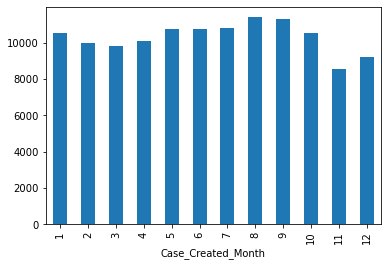

In [17]:
accidents_df.groupby(['Case_Created_Hour'])[
    'OFFENSE_ID'].count().plot(kind='bar')
# Simple analysis shows that accidents start when the workday begins, slowly increase throughout the day and peak at end of day rush hour
plt.show()

accidents_df.groupby(['DISTRICT_ID'])['OFFENSE_ID'].count().plot(kind='bar')
# District 3 has a considerably more Accidents
plt.show()

accidents_df.groupby(['Case_Created_Month'])[
    'OFFENSE_ID'].count().plot(kind='bar')
# Significant drops in accidnets in November and December - correlated to the high number of holidays
# Peak accidents occure in the summer

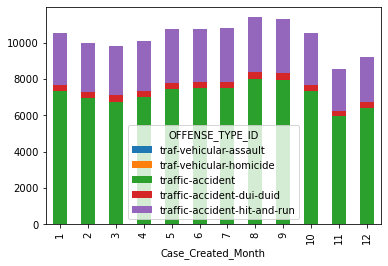

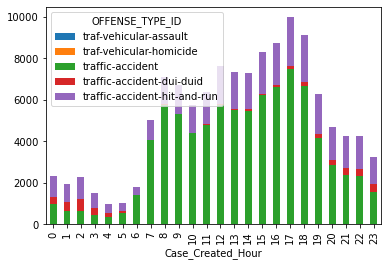

In [18]:
accidents_df.groupby(['Case_Created_Month', 'OFFENSE_TYPE_ID'])[
    'OFFENSE_ID'].count().unstack().plot(kind='bar', stacked=True)
plt.show()
# The type of accident seems evenly distrubuted across months, in relation to total accidents
ax = accidents_df.groupby(['Case_Created_Hour', 'OFFENSE_TYPE_ID'])[
    'OFFENSE_ID'].count().unstack().plot(kind='bar', stacked=True)
plt.show()
# DUI's spike starting at 6pm through 4 am which fits expectation
# Hit and runs stay consistent throughout the day

# Correlation Between Data Sets

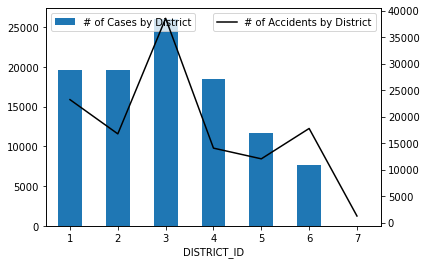

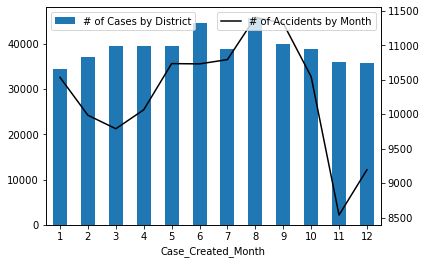

In [19]:
ax = service_request_df.groupby(['Police District'])[
    'Case Summary'].count().plot(kind='bar', stacked=True)
ax2 = accidents_df.groupby(['DISTRICT_ID'])['OFFENSE_ID'].count().plot(
    ax=ax, color='k', secondary_y=True)
ax.legend(['# of Cases by District'], loc='upper left')
ax2.legend(['# of Accidents by District'], loc='upper right')
plt.show()
# A strong correlation between number of cases and number of accidents - most likely driven by underlying population

ax = service_request_df.groupby(['Case_Created_Month'])[
    'Case Summary'].count().plot(kind='bar', stacked=True)
ax2 = accidents_df.groupby(['Case_Created_Month'])['OFFENSE_ID'].count(
).reset_index().plot(y='OFFENSE_ID', ax=ax, color='k', secondary_y=True)
ax.legend(['# of Cases by District'], loc='upper left')
ax2.legend(['# of Accidents by Month'], loc='upper right')
plt.show()
# Both sets of data follow similar seasonal trends, with spikes in summer

# Store Date in a SQLite DB
For this project we use sqlite and download the JDBC bindings to access it from Spark. In a real setting this would be Postgres, AWS Aurora, Cassandra, Hive, etc

In [20]:
import numpy as np
import sqlite3 as sql

In [21]:
from sqlalchemy import create_engine


In [22]:
engine = create_engine('sqlite:///denver_public_data.db', echo=False)

# Remove list from coordinates cleaned as SQLite does not accept that data type
service_request_df['Coordinates cleaned'] = service_request_df['Coordinates cleaned'].map(
    lambda x: ", ".join(list(x)) if x is not None else None)

# write both original data sets to DB
print("Length of service request table: ", write_df_to_sqlite(
    service_request_df, 'service_requests', engine))
print("Length of traffic accidents table: ", write_df_to_sqlite(
    accidents_df, 'traffic_accidents', engine))

Length of service request table:  (470641,)
Length of traffic accidents table:  (123659,)


In [23]:
service_result = engine.execute("SELECT count(*) FROM service_requests")
print("Length of service_requests df: ", len(service_request_df),
      "records in DB", service_result.fetchall())

accident_result = engine.execute("SELECT count(*) FROM traffic_accidents")
print("Length of accidents_df: ", len(accidents_df),
      "records in DB", accident_result.fetchall())

Length of service_requests df:  470641 records in DB [(470641,)]
Length of accidents_df:  123659 records in DB [(123659,)]
